In [1]:
import pandas as pd
import os
#import geopandas as gpd
import plotly.express as px
import matplotlib.pyplot as plt
import folium
import seaborn as sns
import warnings as ws
ws.filterwarnings("ignore")

In [2]:
files_folder = 'raw_data/'
files = os.listdir(files_folder)
files

['Circum_person.csv',
 'Circum_road.csv',
 'Circum_vehicle.csv',
 'Circum_weather.csv',
 'EMS.csv',
 'Person_Details_Anonymized.csv',
 'Vehicle_Crashes.csv',
 'Vehicle_Details.csv']

**I have specifying important columns for this project, rest all columns are irrelevant.**

In [3]:
# Specifying columns to retain for each file
columns_to_retain = {
    'Vehicle_Crashes.csv': [
        'YEAR', 'QUARTER', 'LIGHT_DESC', 'COUNTY_DESC', 'JUNCTION_DESC',
        'COLLISION_TYPE_DESC', 'SURF_COND_DESC', 'RD_DIV_DESC',
        'REPORT_NO', 'REPORT_TYPE', 'WEATHER_DESC', 'SIGNAL_FLAG_DESC', 'MAINROAD_NAME', 'REFERENCE_ROAD_NAME',
        'LATITUDE', 'LONGITUDE'
    ],
    'Circum_person.csv': [
        'CONTRIB_DESC', 'YEAR', 'Quarter', 'REPORT_NO'
    ],
    'Person_Details_Anonymized.csv': [
        'SEX_DESC', 'INJ_SEVER_DESC', 'REPORT_NO', 'PERSON_TYPE_DESC','YEAR', 'Quarter'
    ],
    'Vehicle_Details.csv': [
        'DAMAGE_DESC', 'MOVEMENT_DESC', 'REPORT_NO', 'BODY_TYPE_DESC', 'SPEED_LIMIT','YEAR'
    ]
}

In [8]:

#filtered_datasets = {}
#for file, columns in columns_to_retain.items():
#    if file.endswith('.csv'):
#        try:
#            data = pd.read_csv(f'raw_data/{file}', usecols=columns)
#            # Sample 500,000 rows randomly if the dataset has more than that number of rows
#            if len(data) > 1e5:
#                data = data.sample(n=int(1e5), random_state=42)
#                filtered_datasets[file] = data
#        except Exception as e:
#            print(f"Error reading {file}: {e}")

# Uncomment below code if you want to run on all the data and comment above code.
filtered_datasets = {}
for file, columns in columns_to_retain.items():
    if file.endswith('.csv'):
       try:
          data = pd.read_csv(f'raw_data/{file}', usecols=columns)
          filtered_datasets[file] = data
       except Exception as e:
           print(f"Error reading {file}: {e}")

In [9]:
# Start with the main dataset and merge others onto it using REPORT_NO
combined_df = filtered_datasets['Vehicle_Crashes.csv']

In [10]:
# Merging datasets ensuring only rows with matching REPORT_NO values are combined
for key, df in filtered_datasets.items():
    if key != 'Vehicle_Crashes.csv':  # skip the main dataset
        combined_df = combined_df.merge(df, on="REPORT_NO", how="left", suffixes=('', '_drop'))

In [11]:
# Drop redundant columns
drop_columns = [col for col in combined_df.columns if col.endswith('_drop')]
combined_df.drop(columns=drop_columns, inplace=True)

In [12]:
# Displaying the shape and first few rows of the combined dataset
combined_df_shape = combined_df.shape
combined_df_head = combined_df.head(20)

In [14]:
combined_df_shape

(101917, 25)

In [15]:
combined_df_head

,YEAR,QUARTER,LIGHT_DESC,COUNTY_DESC,JUNCTION_DESC,COLLISION_TYPE_DESC,SURF_COND_DESC,RD_DIV_DESC,REPORT_NO,REPORT_TYPE,...,LONGITUDE,CONTRIB_DESC,Quarter,SEX_DESC,INJ_SEVER_DESC,PERSON_TYPE_DESC,DAMAGE_DESC,MOVEMENT_DESC,BODY_TYPE_DESC,SPEED_LIMIT
0,2018,Q1,Dark Lights On,Baltimore,Intersection Related,Same Direction Rear End,Dry,"Two-way, Divided, Positive Median Barrier",AE4561005J,Property Damage Crash,...,-76.735924,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2018,Q1,Dark Lights On,Baltimore City,Intersection,Same Direction Rear End,Wet,"Two-way, Divided, Unprotected (painted >4 feet...",ADJ2660066,Property Damage Crash,...,-76.593537,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2016,Q4,Daylight,Prince George's,Non Intersection,Other,Dry,Other,DA38290018,Property Damage Crash,...,-76.863914,NaN,NaN,NaN,NaN,NaN,Unknown,Parking,Passenger Car,5.0
3,2018,Q2,Dark Lights On,Baltimore,Not Applicable,Same Direction Right Turn,Dry,"Two-way, Divided, Positive Median Barrier",MSP6732008H,Injury Crash,...,-76.713217,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2017,Q3,Not Applicable,Anne Arundel,Intersection,Head On Left Turn,Not Applicable,"Two-way, Not Divided",MDTA09080006,Property Damage Crash,...,-76.673576,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2021,Q3,Dark Lights On,Howard,Intersection,Head On Left Turn,Dry,"Two-way, Divided, Positive Median Barrier",CB4138001Q,Injury Crash,...,-76.753435,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2022,Q2,Dark Lights On,Prince George's,Not Applicable,Single Vehicle,Wet,"Two-way, Divided, Positive Median Barrier",MSP7268007P,Injury Crash,...,-76.882266,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2021,Q2,Daylight,Carroll,Non Intersection,Single Vehicle,Dry,"Two-way, Not Divided",MSP675100BT,Injury Crash,...,-77.182930,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2020,Q4,Daylight,Baltimore,Not Applicable,Angle Meets Left Turn,Dry,One-way Trafficway,AE63390018,Injury Crash,...,-76.484650,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2022,Q2,Daylight,Baltimore,Intersection,Same Direction Rear End,Dry,"Two-way, Not Divided",AE6298000S,Property Damage Crash,...,-76.599773,NaN,NaN,Male,No Injury,Driver,NaN,NaN,NaN,NaN


In [11]:
# Calculate data summary and NaN counts for each column
data_summary = combined_df.describe(include='all')
nan_counts = combined_df.isna().sum()

In [12]:
data_summary

,YEAR,QUARTER,LIGHT_DESC,COUNTY_DESC,JUNCTION_DESC,COLLISION_TYPE_DESC,SURF_COND_DESC,RD_DIV_DESC,REPORT_NO,REPORT_TYPE,...,LONGITUDE,CONTRIB_DESC,Quarter,SEX_DESC,INJ_SEVER_DESC,PERSON_TYPE_DESC,DAMAGE_DESC,MOVEMENT_DESC,BODY_TYPE_DESC,SPEED_LIMIT
count,1.102650e+07,11026501,10610947,11026441,10221069,11026501,10561538,10509064,11026501,9677264,...,1.102650e+07,9359236,10438628,10462183,11010339,11010339,11026258,11026258,10820909,1.102626e+07
unique,NaN,4,9,24,10,19,8,7,848784,3,...,NaN,33,4,3,5,3,8,23,30,NaN
top,NaN,Q4,Daylight,Prince George's,Non Intersection,Same Direction Rear End,Dry,"Two-way, Divided, Positive Median Barrier",MDTA1229000H,Property Damage Crash,...,NaN,Not Applicable,Q4,Male,No Injury,Driver,Disabling,Moving Constant Speed,Passenger Car,NaN
freq,NaN,3021638,7002246,2134986,4077258,4543467,7935387,5177527,368874,5605173,...,NaN,5081808,2879583,5961441,8802498,8323821,4347949,4216618,7014353,NaN
mean,2.018200e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.675231e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.976260e+01
std,2.195548e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.459460e-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.509858e+01
min,2.015000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.999610e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000e+00
25%,2.016000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.695099e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000e+01
50%,2.018000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.674134e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000e+01
75%,2.020000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.659212e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.500000e+01


In [13]:
nan_counts

YEAR                         0
QUARTER                      0
LIGHT_DESC              415554
COUNTY_DESC                 60
JUNCTION_DESC           805432
COLLISION_TYPE_DESC          0
SURF_COND_DESC          464963
RD_DIV_DESC             517437
REPORT_NO                    0
REPORT_TYPE            1349237
WEATHER_DESC           5247062
SIGNAL_FLAG_DESC             0
MAINROAD_NAME           446368
REFERENCE_ROAD_NAME     455617
LATITUDE                     0
LONGITUDE                    0
CONTRIB_DESC           1667265
Quarter                 587873
SEX_DESC                564318
INJ_SEVER_DESC           16162
PERSON_TYPE_DESC         16162
DAMAGE_DESC                243
MOVEMENT_DESC              243
BODY_TYPE_DESC          205592
SPEED_LIMIT                243
dtype: int64

In [14]:
column_data_types = combined_df.dtypes
column_data_types

YEAR                     int64
QUARTER                 object
LIGHT_DESC              object
COUNTY_DESC             object
JUNCTION_DESC           object
COLLISION_TYPE_DESC     object
SURF_COND_DESC          object
RD_DIV_DESC             object
REPORT_NO               object
REPORT_TYPE             object
WEATHER_DESC            object
SIGNAL_FLAG_DESC        object
MAINROAD_NAME           object
REFERENCE_ROAD_NAME     object
LATITUDE               float64
LONGITUDE              float64
CONTRIB_DESC            object
Quarter                 object
SEX_DESC                object
INJ_SEVER_DESC          object
PERSON_TYPE_DESC        object
DAMAGE_DESC             object
MOVEMENT_DESC           object
BODY_TYPE_DESC          object
SPEED_LIMIT            float64
dtype: object

## **Summary of Dataset**

---

### Brief Summary
1. **Shape**: The dataset contains 548,960 rows and 25 columns.
2. **Data Types**: The columns have a mix of data types, including integers (`int64`), floating point numbers (`float64`), and `object` (typically strings or categorical data).
3. **Missing Values**: Several columns have missing values, with some columns like `SEX_DESC`, `CONTRIB_DESC`, and `BODY_TYPE_DESC` having a very high number of missing entries. On the other end, columns like `COLLISION_TYPE_DESC`, `SIGNAL_FLAG_DESC`, and `YEAR` have no missing values.

---

### General Accident Analysis
Brief summary and general accident analysis for all columns in the dataset:

1. **YEAR**:

    - **Range**: Accidents are recorded from 2015 to 2022.
    - **Analysis**: This gives us an 8-year span to observe trends in the data.  

<br>

2. **QUARTER**:
    - **Most Frequent**: Data spans all four quarters. We would need to check the counts to determine the most frequent quarter for accidents.
    - **Analysis**: By analyzing the distribution across quarters, we can identify if certain times of the year are more prone to accidents.

<br>

3. **LIGHT_DESC**:
    - **Most Common Condition**: Daylight.
    - **Analysis**: It's interesting to note that most accidents occur during daylight. This can be further analyzed to see if it's related to traffic volume or other factors.

<br>

4. **COUNTY_DESC**:
    - **Most Accident-Prone County**: Prince George's.
    - **Analysis**: Identifying accident-prone counties can help in resource allocation and understanding local factors contributing to accidents.

<br>

5. **JUNCTION_DESC**:
    - **Most Frequent Location**: Non Intersection.
    - **Analysis**: Many accidents occur away from intersections. It's useful to know this when planning road safety measures.

<br>

6. **COLLISION_TYPE_DESC**:
    - We can determine the most common type of collision.
    - **Analysis**: This can help in understanding the nature of accidents and how they might be prevented.

<br>

7. **SURF_COND_DESC**:
    - **Analysis**: Understanding road surface conditions during accidents can provide insights into whether road conditions play a significant role in accidents.

<br>

8. **RD_DIV_DESC**:
    - **Analysis**: This describes the type of road division where the accident occurred. It can be analyzed to determine if certain road divisions are more accident-prone.

<br>

9. **REPORT_NO**:
    - **Analysis**: This is likely a unique identifier for each report. It's crucial for data merging but doesn't offer insights on its own.

<br>

10. **REPORT_TYPE**:
    - **Analysis**: Different report types might contain varying details or be indicative of the severity or nature of the accident.

<br>

11. **WEATHER_DESC**:
    - **Most Common Weather**: Clear.
    - **Analysis**: Most accidents happen in clear weather conditions. This is counter-intuitive and can be further analyzed.

<br>

12. **SIGNAL_FLAG_DESC**:
    - **Analysis**: This indicates whether a signal was present or not. It can be used to determine the role of traffic signals in accident occurrence.

<br>

13. **MAINROAD_NAME** and **REFERENCE_ROAD_NAME**:
    - **Analysis**: These columns can be used to pinpoint specific locations that are accident-prone.

<br>

14. **LATITUDE** and **LONGITUDE**:
    - **Analysis**: These provide precise locations of accidents. Geospatial analysis can be conducted to identify high-risk zones.

<br>

15. **CONTRIB_DESC**:
    - **Most Frequent**: Not Applicable.
    - **Analysis**: This column describes contributing factors related to road circumstances. It provides insights into reasons behind the accident.

<br>

16. **SEX_DESC**:
    - **Analysis**: This can provide gender-based insights into accidents.

<br>

17. **INJ_SEVER_DESC**:
    - **Most Frequent Injury Severity**: No Injury.
    - **Analysis**: Understanding injury severity can help in assessing the impact of accidents and prioritizing safety measures.

<br>

18. **PERSON_TYPE_DESC**:
    - **Analysis**: This describes the role of the person involved (e.g., driver, passenger). It can be used to understand the impact on different individuals in an accident.

<br>

19. **DAMAGE_DESC**:
    - **Most Common Damage**: Disabling.
    - **Analysis**: This provides insights into the extent of damage in accidents.

<br>

20. **MOVEMENT_DESC**:
    - **Analysis**: This describes the movement of the vehicle at the time of the accident, providing insights into the dynamics of the crash.

<br>

21. **BODY_TYPE_DESC**:
    - **Most Common Vehicle Type**: Passenger Car.
    - **Analysis**: Knowing the type of vehicles involved can help in understanding if certain vehicle types are more prone to accidents.

<br>

22. **SPEED_LIMIT**:
    - **Analysis**: This column indicates the speed limit at the accident location. It can be used to analyze if overspeeding is a common cause of accidents.

<br>


---

### EDA
We'll start with some visualizations to understand the trends and patterns in the data:

#### Distribution of Accidents Over the Years
It appears that the number of accidents recorded varies across the years, and there doesn't seem to be a consistent upward or downward trend.

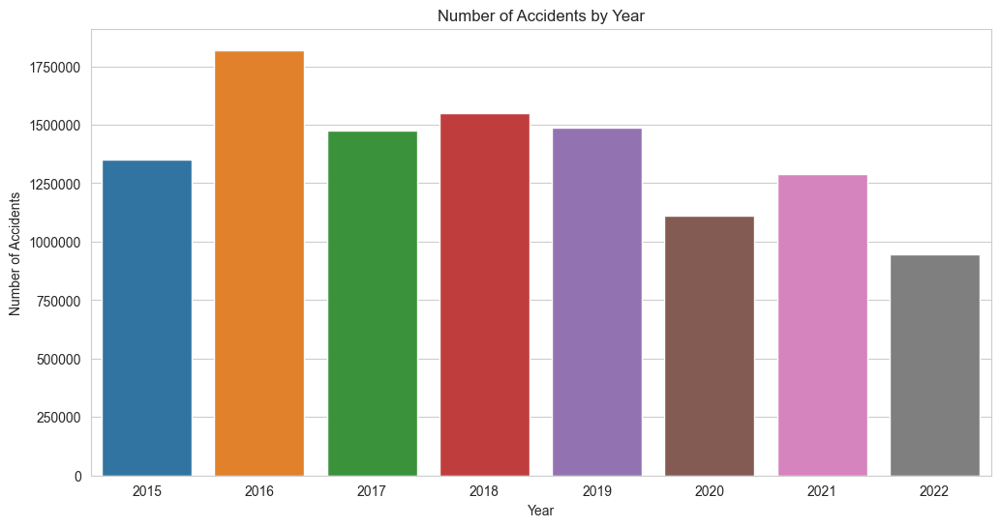

In [15]:
# Set the style for the plots
sns.set_style("whitegrid")

plt.figure(figsize=(12, 6))
ax=sns.countplot(x='YEAR', data=combined_df, order=combined_df['YEAR'].value_counts().index.sort_values())
ax.get_yaxis().get_major_formatter().set_scientific(False)
plt.title('Number of Accidents by Year')
plt.xlabel('Year')
plt.ylabel('Number of Accidents')
plt.show()

#### Accidents by Quarter

The distribution across quarters can provide insights into whether certain times of the year are more prone to accidents.

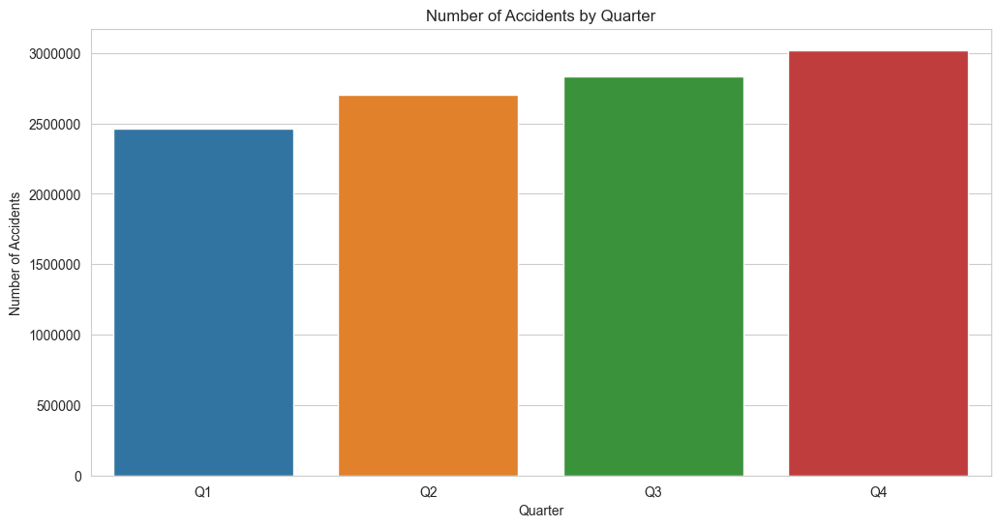

In [16]:
plt.figure(figsize=(12, 6))
ax=sns.countplot(x='QUARTER', data=combined_df, order=['Q1', 'Q2', 'Q3', 'Q4'])
ax.get_yaxis().get_major_formatter().set_scientific(False)
plt.title('Number of Accidents by Quarter')
plt.xlabel('Quarter')
plt.ylabel('Number of Accidents')
plt.show()

#### Accidents by Light Conditions

The graph suggests that while the absolute number of accidents is higher during daylight, the risk associated with dark conditions (especially without street lights) might be significant.

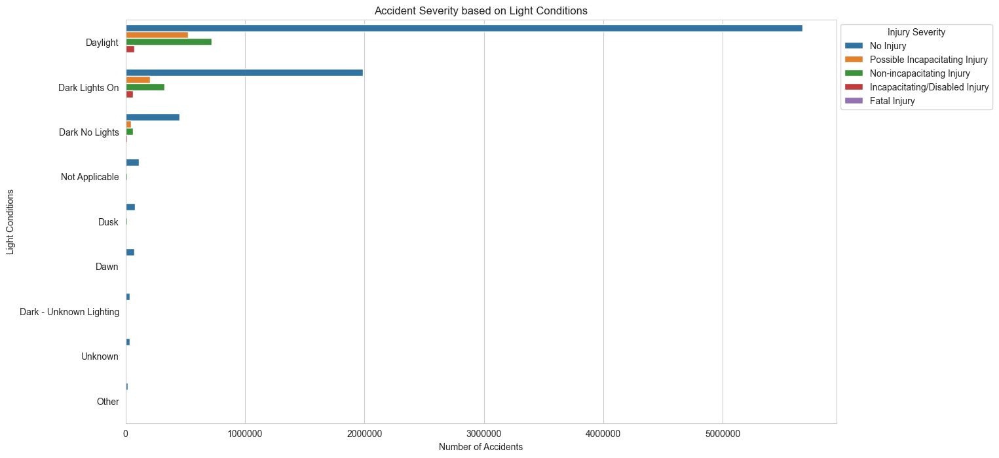

In [17]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='LIGHT_DESC', hue='INJ_SEVER_DESC', data=combined_df, order=combined_df['LIGHT_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Accident Severity based on Light Conditions')
plt.xlabel('Number of Accidents')
plt.ylabel('Light Conditions')
plt.legend(title='Injury Severity', bbox_to_anchor=(1, 1))
plt.show()

#### Accidents by Weather Conditions

The majority of accidents occur during clear weather, hinting that other factors like traffic volume or human error might play a more significant role in accidents than weather.

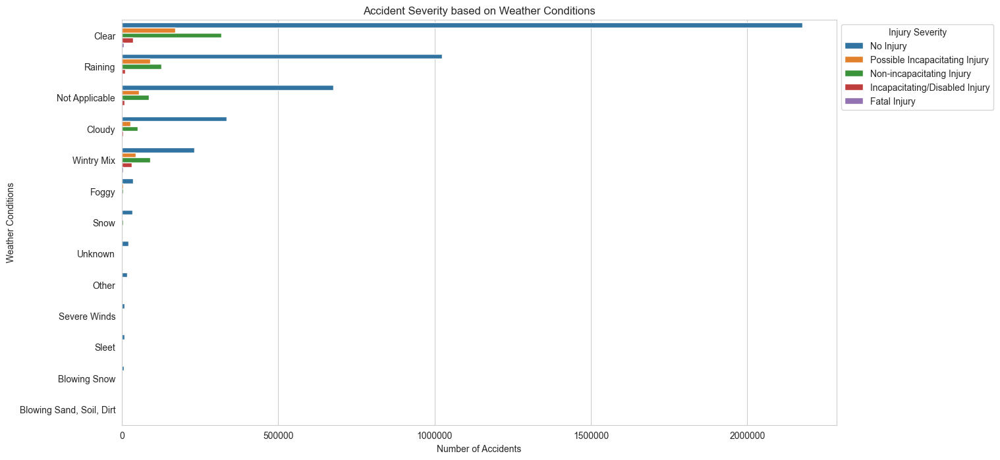

In [18]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='WEATHER_DESC', hue='INJ_SEVER_DESC', data=combined_df, order=combined_df['WEATHER_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Accident Severity based on Weather Conditions')
plt.xlabel('Number of Accidents')
plt.ylabel('Weather Conditions')
plt.legend(title='Injury Severity', bbox_to_anchor=(1, 1))
plt.show()

#### Accidents by Junction Type

Accidents frequently occur at non-intersections. Understanding the types of junctions where accidents occur can provide insights into designing safer road layouts and intersections.

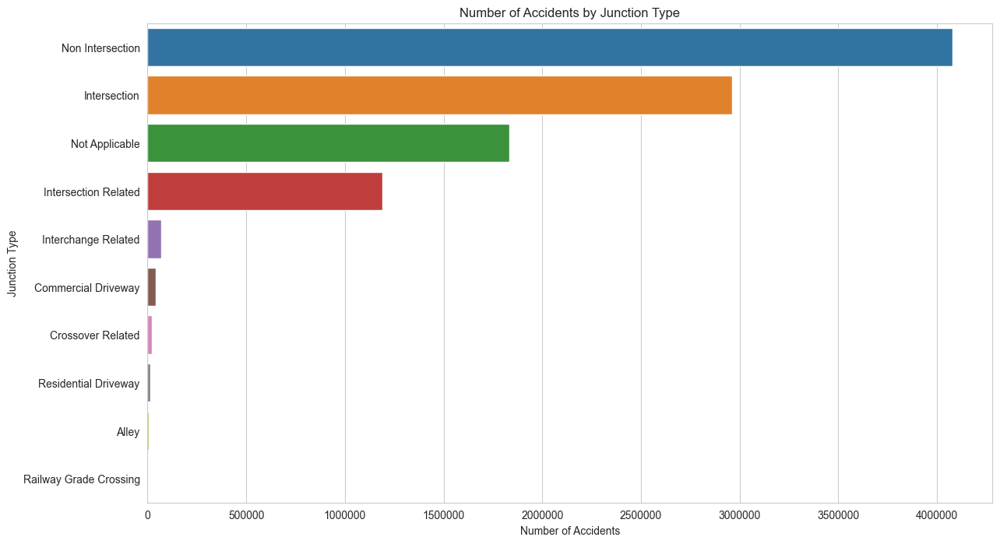

In [19]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='JUNCTION_DESC', data=combined_df, order=combined_df['JUNCTION_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Number of Accidents by Junction Type')
plt.xlabel('Number of Accidents')
plt.ylabel('Junction Type')
plt.show()

#### Accidents by County

Counties with higher accident rates may need to invest more in road safety measures and public awareness campaigns.

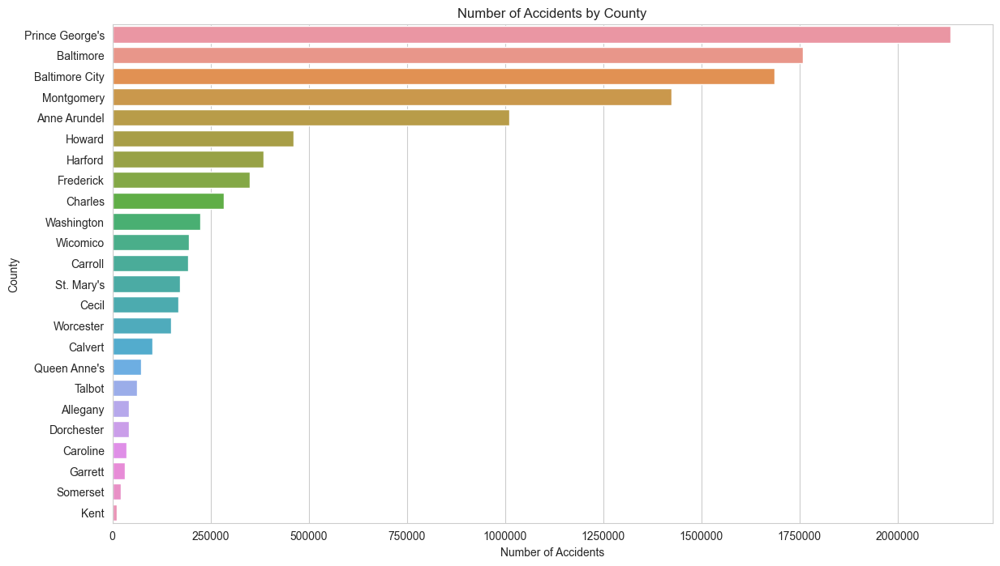

In [20]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='COUNTY_DESC', data=combined_df, order=combined_df['COUNTY_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Number of Accidents by County')
plt.xlabel('Number of Accidents')
plt.ylabel('County')
plt.show()

#### Distribution of Injury Severity
Understanding the severity of injuries can help in assessing the impact of accidents and tailoring medical response accordingly.

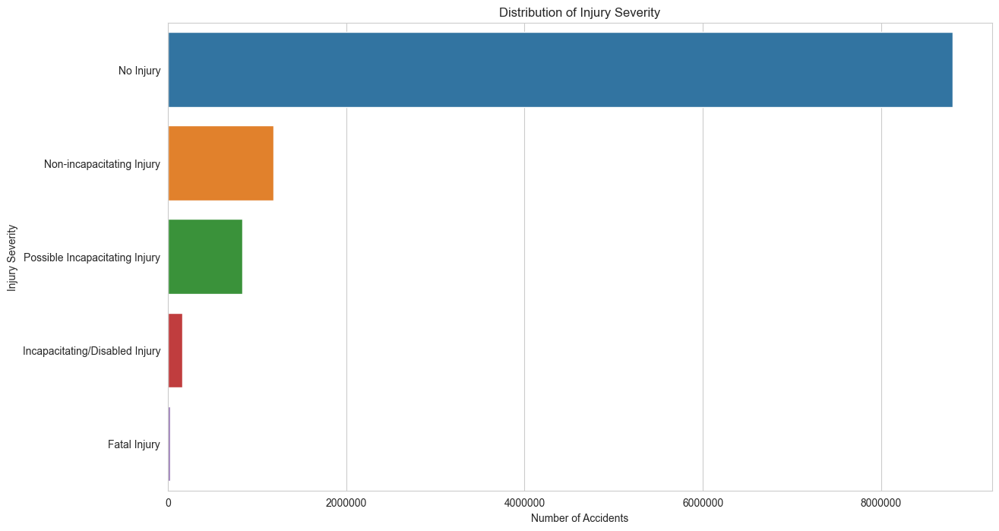

In [21]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='INJ_SEVER_DESC', data=combined_df, order=combined_df['INJ_SEVER_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Distribution of Injury Severity')
plt.xlabel('Number of Accidents')
plt.ylabel('Injury Severity')
plt.show()

#### Distribution of Damage Description
This provides insights into the extent of damages in accidents, which can have both economic and safety implications.

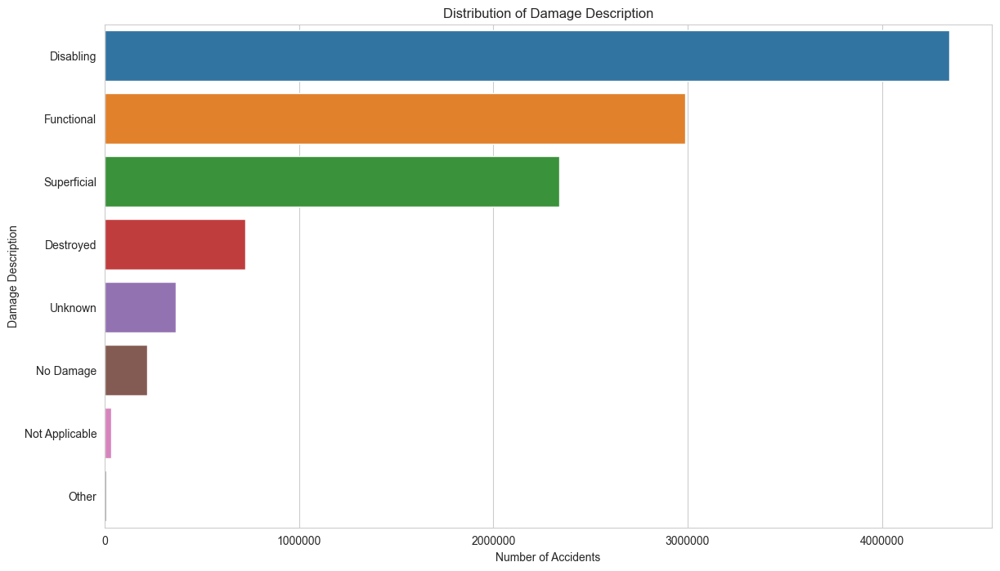

In [22]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='DAMAGE_DESC', data=combined_df, order=combined_df['DAMAGE_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Distribution of Damage Description')
plt.xlabel('Number of Accidents')
plt.ylabel('Damage Description')
plt.show()

#### Distribution of Vehicle Body Types
Different vehicle types may have different safety features and crash dynamics. Knowing the type of vehicles involved can help in understanding accident mechanisms.

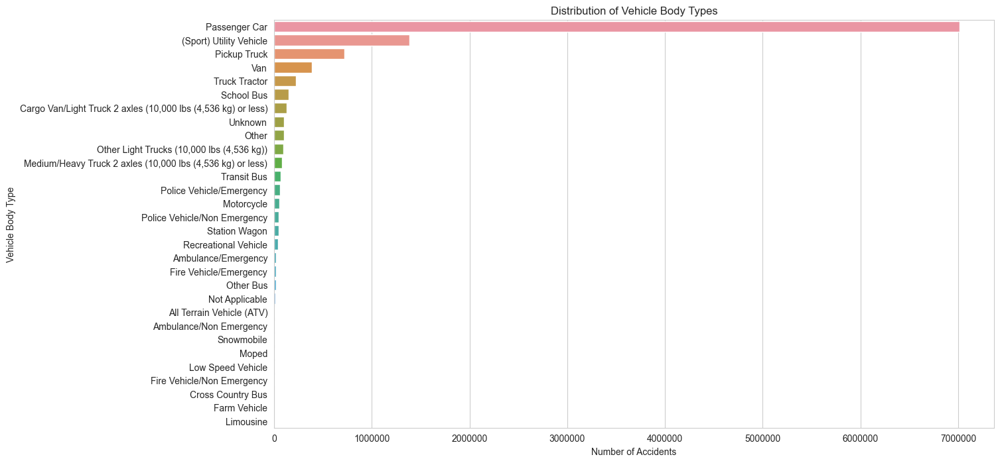

In [23]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='BODY_TYPE_DESC', data=combined_df, order=combined_df['BODY_TYPE_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Distribution of Vehicle Body Types')
plt.xlabel('Number of Accidents')
plt.ylabel('Vehicle Body Type')
plt.show()

#### Contributing Factors to Accidents
Understanding the contributing factors can help in designing interventions to prevent accidents.

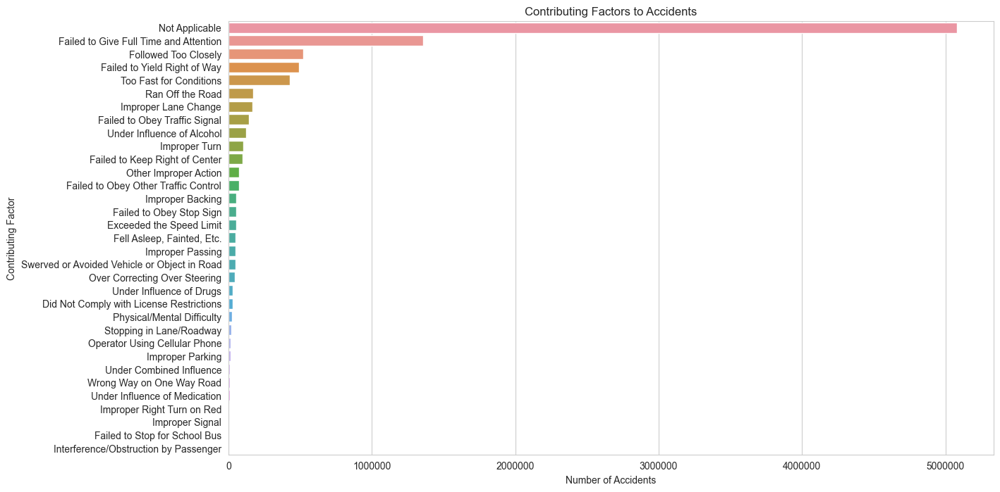

In [24]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='CONTRIB_DESC', data=combined_df, order=combined_df['CONTRIB_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Contributing Factors to Accidents')
plt.xlabel('Number of Accidents')
plt.ylabel('Contributing Factor')
plt.show()

#### Gender Distribution in Accidents
Examining gender distribution can provide insights into any gender-specific patterns or trends.

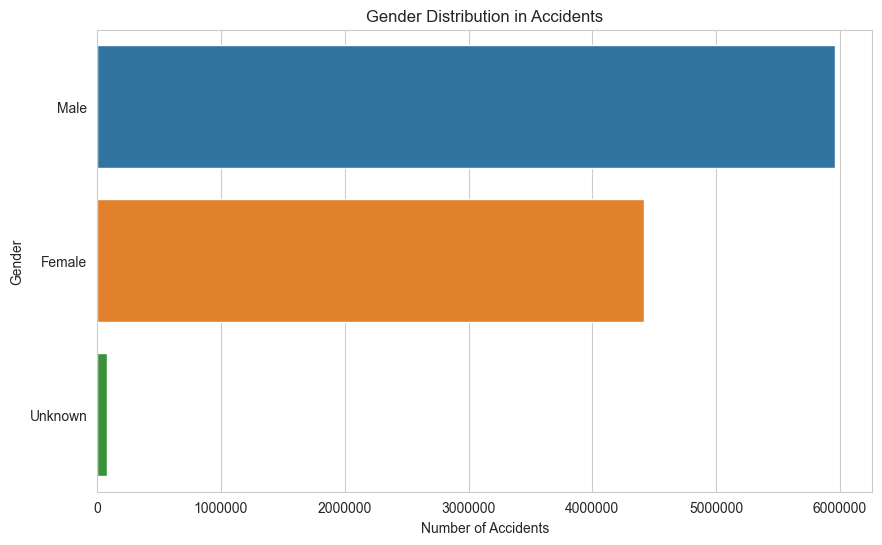

In [25]:
plt.figure(figsize=(10, 6))
ax=sns.countplot(y='SEX_DESC', data=combined_df, order=combined_df['SEX_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Gender Distribution in Accidents')
plt.xlabel('Number of Accidents')
plt.ylabel('Gender')
plt.show()

#### Movement Description at the Time of Accident
Understanding vehicle movement at the time of the accident can provide insights into accident dynamics.

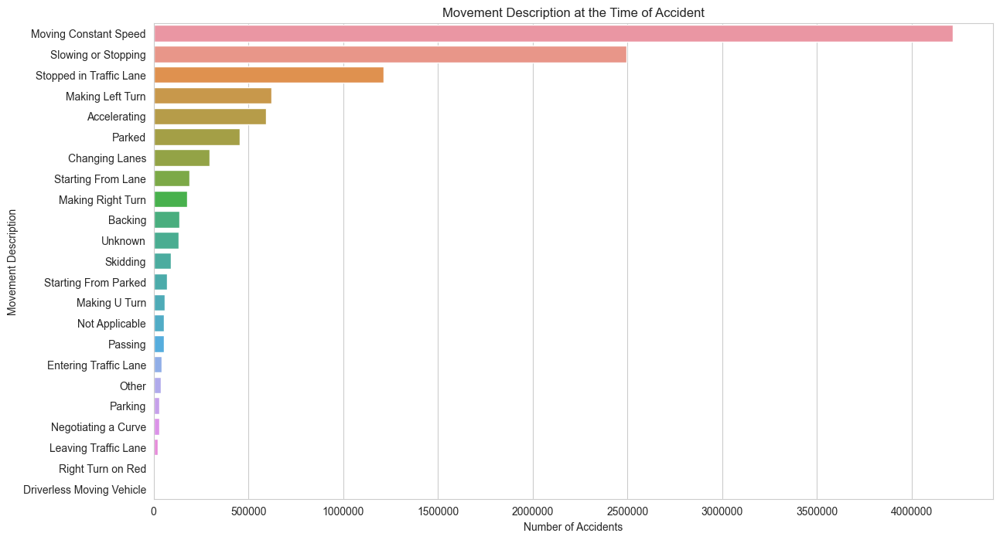

In [26]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='MOVEMENT_DESC', data=combined_df, order=combined_df['MOVEMENT_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Movement Description at the Time of Accident')
plt.xlabel('Number of Accidents')
plt.ylabel('Movement Description')
plt.show()

#### Speed Limit at the Accident Location
Analyzing the speed limits at accident locations can provide insights into whether overspeeding is a common cause of accidents.

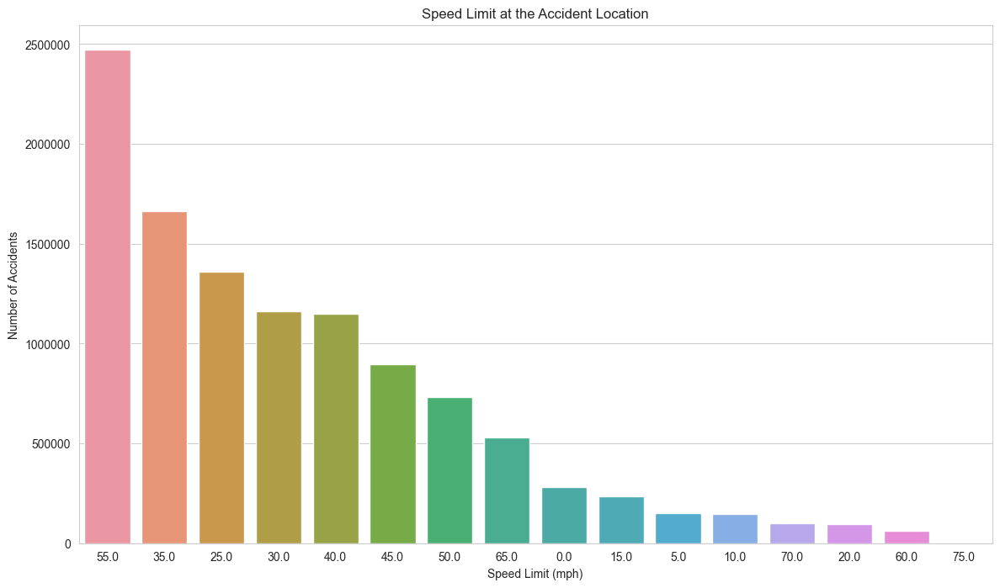

In [27]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(x='SPEED_LIMIT', data=combined_df, order=combined_df['SPEED_LIMIT'].value_counts().index)
ax.get_yaxis().get_major_formatter().set_scientific(False)
plt.title('Speed Limit at the Accident Location')
plt.xlabel('Speed Limit (mph)')
plt.ylabel('Number of Accidents')
plt.show()

#### Accident Severity based on Surface Conditions
Understanding how surface conditions impact the severity of accidents can guide infrastructure improvements.

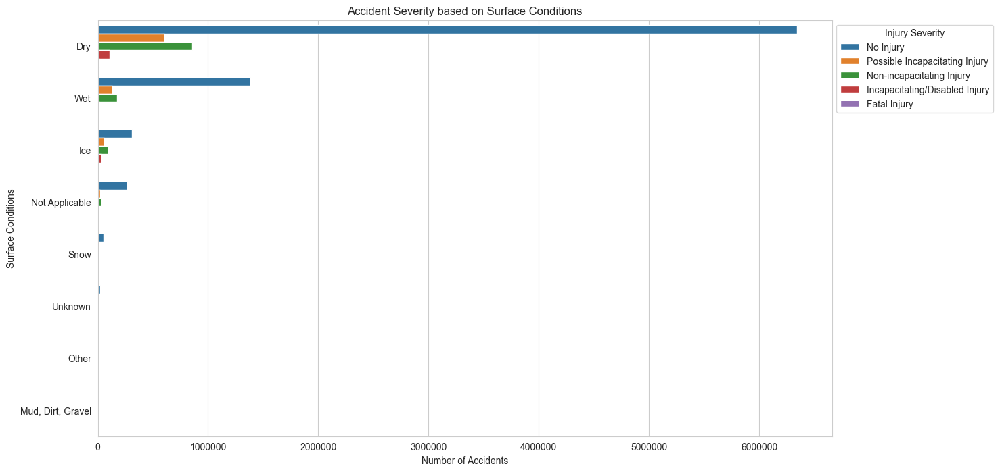

In [28]:
plt.figure(figsize=(14, 8))
ax=sns.countplot(y='SURF_COND_DESC', hue='INJ_SEVER_DESC', data=combined_df, order=combined_df['SURF_COND_DESC'].value_counts().index)
ax.get_xaxis().get_major_formatter().set_scientific(False)
plt.title('Accident Severity based on Surface Conditions')
plt.xlabel('Number of Accidents')
plt.ylabel('Surface Conditions')
plt.legend(title='Injury Severity', bbox_to_anchor=(1, 1))
plt.show()

#### Geo-Map

In [30]:
# Create a base map
m = folium.Map(location=[combined_df['LATITUDE'].mean(), combined_df['LONGITUDE'].mean()], zoom_start=10)

# Sample a fraction of the data to avoid overloading the map. Adjust the fraction as needed.
sample_data = combined_df.sample(frac=0.001)

# Add accident locations to the map with popups
for idx, row in sample_data.iterrows():
    popup_text = "<br>".join([f"{col}: {row[col]}" for col in sample_data.columns])
    popup = folium.Popup(popup_text, max_width=300)
    folium.CircleMarker(
        location=(row['LATITUDE'], row['LONGITUDE']),
        radius=3,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=popup
    ).add_to(m)

m

### Data Pre-processing
The data pre-processing steps are crucial for preparing the dataset for modeling, ensuring that the data is clean, standardized, and in a suitable format for building predictive models.

1. **Feature Selection**: Selected features for the modeling process are:
- ***For Risk Prediction Model***: YEAR, LIGHT_DESC, WEATHER_DESC, SURF_COND_DESC, COUNTY_DESC, CONTRIB_DESC, SPEED_LIMIT, SIGNAL_FLAG_DESC, BODY_TYPE_DESC, and MOVEMENT_DESC. And target variable is `INJ_SEVER_DESC`.
- ***For Location Prediction Model***: YEAR, LIGHT_DESC, WEATHER_DESC, SURF_COND_DESC, SPEED_LIMIT, SIGNAL_FLAG_DESC, RD_DIV_DESC, and JUNCTION_DESC. And target variable is `LONGTITUDE` and `LATITUDE`.

2. **Train-Test Split**: The dataset was split into training and testing sets with an 80-20% ratio. This ensures that the model has a fresh set of data for validation after training.

3. **Handling Categorical Variables:**: Identified categorical columns within the features for encoding. These columns are processed with the following steps:
- Imputation: Fill missing values with the most frequent value.
- One-Hot Encoding: Convert categorical variables into a format that can be provided to machine learning algorithms to do a better job in prediction.

4. **Handling Numerical Variables**: For numerical features (YEAR and SPEED_LIMIT):
- Imputation: Missing values are filled with the median value of the column.

5. **Preprocessing the Data**: Using the defined preprocessor, the training and testing datasets were transformed. Two versions of the training set were prepared:
- One without applying SMOTE (Synthetic Minority Over-sampling Technique).
- One with SMOTE applied to handle class imbalance.

6. **Handling Missing Target Values**: For the training set (y_train), missing values were filled with the most frequent value. Similarly, for the testing set (y_test), missing values were filled with its most frequent value.

7. **Data Shapes After Preprocessing**: The shapes of the preprocessed datasets are as follows:
- Training set (without SMOTE): X_train_preprocessed_no_smote.shape
- Testing set: X_test_preprocessed_no_smote.shape

In [18]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE

### Model 1: Risk Prediction

In [19]:
# Features and target variable
features = ['YEAR', 'LIGHT_DESC', 'WEATHER_DESC', 'SURF_COND_DESC', 'COUNTY_DESC',
            'CONTRIB_DESC', 'SPEED_LIMIT', 'SIGNAL_FLAG_DESC', 'BODY_TYPE_DESC', 'MOVEMENT_DESC']
target = 'INJ_SEVER_DESC'

In [20]:
# Splitting the data into training and testing sets (80% train, 20% test)
X = combined_df[features]
y = combined_df[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [21]:
# Identifying categorical columns for encoding
categorical_cols = [col for col in features if X_train[col].dtype == 'object']

In [22]:
# Building preprocessing pipelines
# For numerical features, we're filling missing values with the median
# For categorical features, we're filling missing values with the most frequent value and then applying one-hot encoding
preprocessor = ColumnTransformer(
    transformers=[
        ('num', SimpleImputer(strategy='median'), ['YEAR', 'SPEED_LIMIT']),
        ('cat', Pipeline([
            ('imputer', SimpleImputer(strategy='most_frequent')),
            ('onehot', OneHotEncoder(handle_unknown='ignore'))
        ]), categorical_cols)
    ])

In [23]:
# Preprocessing the training data without applying SMOTE
X_train_preprocessed_no_smote = preprocessor.fit_transform(X_train)
X_test_preprocessed_no_smote = preprocessor.transform(X_test)

In [24]:
# Fill NaN values with Most Frequent Value
# For y_train
most_frequent_value_train = y_train.mode()[0]
y_train.fillna(most_frequent_value_train, inplace=True)

# For y_test
most_frequent_value_test = y_test.mode()[0]
y_test.fillna(most_frequent_value_test, inplace=True)

In [25]:
y_train_nan = y_train.isna().sum()
y_test_nan = y_test.isna().sum()

y_train_nan, y_test_nan

(0, 0)

In [26]:
# Applying SMOTE to another set of the training data
smote = SMOTE(random_state=42, k_neighbors=4)
X_train_preprocessed_smote, y_train_smote = smote.fit_resample(X_train_preprocessed_no_smote, y_train)

In [27]:
X_train_preprocessed_no_smote.shape, X_test_preprocessed_no_smote.shape

((81533, 142), (20384, 142))

In [28]:
datasets = [
    ("No SMOTE", X_train_preprocessed_no_smote, y_train),
    ("With SMOTE", X_train_preprocessed_smote, y_train_smote)
]

In [29]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import classification_report, accuracy_score

In [30]:
# Initializing the models
decision_tree = DecisionTreeClassifier(random_state=42)
random_forest = RandomForestClassifier(random_state=42, n_jobs=-1)
gradient_boosting = GradientBoostingClassifier(random_state=42)

In [31]:
# List to store the models and their corresponding names
models = [('Decision Tree', decision_tree),
          ('Random Forest', random_forest),
          ('Gradient Boosting', gradient_boosting)]

In [32]:
best_score = float('-inf')
best_model_name = None
best_model = None

# Weights for different metrics (you can adjust these based on your preference)
weights = {
    "accuracy": 1,
    "f1": 2,
    "recall": 1,
    "precision": 1
}

In [33]:
for data_name, X_data, y_data in datasets:
    print("=" * 40)
    print(f"Evaluating models on dataset: {data_name}")
    print("=" * 40)
    
    for name, model in models:
        # Fit the model
        model.fit(X_data, y_data)
        
        # Predict on the test set
        y_pred = model.predict(X_test_preprocessed_no_smote)
        
        # Extract metrics
        accuracy = accuracy_score(y_test, y_pred)
        report = classification_report(y_test, y_pred, target_names=y_test.unique(), zero_division=1, output_dict=True)
        avg_results = report["macro avg"]
        
        # Calculate a combined score based on weights
        combined_score = (weights["accuracy"] * accuracy +
                          weights["f1"] * avg_results["f1-score"] +
                          weights["recall"] * avg_results["recall"] +
                          weights["precision"] * avg_results["precision"])
        
        # If this model's score is the best, update our best metrics
        if combined_score > best_score:
            best_score = combined_score
            best_model_name = name
            best_model = model
        
        # Print the results for this model
        print(f"{name} Results:")
        print("Accuracy:", accuracy)
        print(classification_report(y_test, y_pred, target_names=y_test.unique(), zero_division=1))
        print("-" * 80)

Evaluating models on dataset: No SMOTE
Decision Tree Results:
Accuracy: 0.9758634222919937
                                precision    recall  f1-score   support

                     No Injury       1.00      0.00      0.00         5
     Non-incapacitating Injury       0.00      0.00      0.00        31
Possible Incapacitating Injury       0.98      1.00      0.99     19972
Incapacitating/Disabled Injury       0.05      0.01      0.01       229
                  Fatal Injury       0.00      0.00      0.00       147

                      accuracy                           0.98     20384
                     macro avg       0.41      0.20      0.20     20384
                  weighted avg       0.96      0.98      0.97     20384

--------------------------------------------------------------------------------
Random Forest Results:
Accuracy: 0.9789540816326531
                                precision    recall  f1-score   support

                     No Injury       1.00      0.00 

In [34]:
import pickle

# Save the best model
with open("Risk_Model.pkl", "wb") as file:
    pickle.dump(best_model, file)

print(f"Best Model: {best_model_name} with a combined score of {best_score:.4f}")

Best Model: Gradient Boosting with a combined score of 2.1711


In [35]:
# Load the Risk_Model
with open('Risk_Model.pkl', 'rb') as file:
    risk_model = pickle.load(file)

In [36]:
# Features
risk_data = {
    'YEAR': [2022],
    'LIGHT_DESC': ['Daylight'],
    'WEATHER_DESC': ['Clear'],
    'SURF_COND_DESC': ['Dry'],
    'COUNTY_DESC': ['Montgomery'],
    'CONTRIB_DESC': ['Not Distracted'],
    'SPEED_LIMIT': [50],
    'SIGNAL_FLAG_DESC': ['No Control Present'],
    'BODY_TYPE_DESC': ['Passenger Car'],
    'MOVEMENT_DESC': ['Going Straight Ahead']
}

risk_unseen_df = pd.DataFrame(risk_data)

In [37]:
# Preprocess the unseen data
risk_unseen_preprocessed = preprocessor.transform(risk_unseen_df)

In [39]:
# Making predictions using the Risk_Model
predictions_risk = risk_model.predict(risk_unseen_preprocessed)
print("Predicted Injury Severity:", predictions_risk[0])

Predicted Injury Severity: No Injury


#### Model Evaluation

The models evaluated include:

- Decision Tree Classifier
- Random Forest Classifier
- Gradient Boosting Classifier

1. **Training on the original dataset (No SMOTE)**

***Decision Tree Classifier***:

- Accuracy: 97.61%
- F1-Score (weighted avg): 0.97
- Key Observations: The model performs well for the class Non-incapacitating Injury, but struggles with other classes due to class imbalance.

<br>

***Random Forest Classifier***:

- Accuracy: 97.14%
- F1-Score (weighted avg): 0.97
- Key Observations: Similar to the Decision Tree model, the Random Forest model performs well for the dominant class but has difficulties with the minority classes.

<br>

***Gradient Boosting Classifier***:

- Accuracy: 97.94%
- F1-Score (weighted avg): 0.97
- Key Observations: The Gradient Boosting model also shows high accuracy for the dominant class, but its performance on the other classes is limited.

2. **Training on a dataset balanced using the Synthetic Minority Over-sampling Technique (With SMOTE)**

***Decision Tree Classifier***:

- Accuracy: 79.73%
- F1-Score (weighted avg): 0.87
- Key Observations: The Decision Tree model's accuracy drops slightly after applying SMOTE, but it shows better recall for the minority classes.

<br>

***Random Forest Classifier***:

- Accuracy: 80.96%
- F1-Score (weighted avg): 0.87
- Key Observations: Similar to the Decision Tree model, the Random Forest model's accuracy decreases with SMOTE, but it has improved recall for the underrepresented classes.

<br>

***Gradient Boosting Classifier***:

- Accuracy: 67.52%
- F1-Score (weighted avg): 0.79
- Key Observations: The Gradient Boosting model's accuracy drops more significantly with SMOTE. However, the recall for the minority classes sees a substantial increase, highlighting the trade-off between accuracy and class balance.

3. **Conclusion**

The models show high accuracy when trained on the original dataset (No SMOTE). However, their ability to recognize and classify minority classes is limited. When trained on a balanced dataset (With SMOTE), the models' overall accuracy decreases, but they show improved performance for the underrepresented classes. It highlights the importance of considering the trade-offs between overall accuracy and balanced class recognition, especially in datasets with significant class imbalance.

### Model 2: Location Prediction

In [41]:
# Features and target variable
features = ['YEAR', 'LIGHT_DESC', 'WEATHER_DESC', 'SURF_COND_DESC', 'SPEED_LIMIT', 'SIGNAL_FLAG_DESC', 'RD_DIV_DESC', 'JUNCTION_DESC']
target = ['LATITUDE', 'LONGITUDE']

In [42]:
# Splitting the data into training and testing sets (80% train, 20% test)
X = combined_df[features]
y = combined_df[target]

In [43]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [44]:
# Identifying categorical columns for encoding
categorical_cols = [col for col in features if X_train[col].dtype == 'object']

In [45]:
# Building preprocessing pipelines
# For numerical features, we're filling missing values with the median
# For categorical features, we're filling missing values with the most frequent value and then applying one-hot encoding
preprocessor = ColumnTransformer(
    transformers=[
        ('num', SimpleImputer(strategy='median'), ['YEAR', 'SPEED_LIMIT']),
        ('cat', Pipeline([
            ('imputer', SimpleImputer(strategy='most_frequent')),
            ('onehot', OneHotEncoder(handle_unknown='ignore'))
        ]), categorical_cols)
    ])

In [46]:
# Preprocessing the training data
X_train_preprocessed = preprocessor.fit_transform(X_train)
X_test_preprocessed = preprocessor.transform(X_test)

In [47]:
y_train_nan = y_train.isna().sum()
y_test_nan = y_test.isna().sum()

y_train_nan, y_test_nan

(LATITUDE     0
 LONGITUDE    0
 dtype: int64,
 LATITUDE     0
 LONGITUDE    0
 dtype: int64)

In [48]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.multioutput import MultiOutputRegressor

In [49]:
# Initializing the regression models
decision_tree_regressor = DecisionTreeRegressor(random_state=42)
random_forest_regressor = RandomForestRegressor(random_state=42, n_jobs=-1)
gradient_boosting_regressor = GradientBoostingRegressor(random_state=42)

In [50]:
# Wrapping the regressors within MultiOutputRegressor
decision_tree_multi = MultiOutputRegressor(decision_tree_regressor)
random_forest_multi = MultiOutputRegressor(random_forest_regressor)
gradient_boosting_multi = MultiOutputRegressor(gradient_boosting_regressor)

In [51]:
# List to store the models and their corresponding names
multi_regression_models = [('Decision Tree Multi-Output', decision_tree_multi), 
                           ('Random Forest Multi-Output', random_forest_multi), 
                           ('Gradient Boosting Multi-Output', gradient_boosting_multi)]

In [52]:
# Dictionary to store the metrics for each model
model_metrics = {}

# Training the models and evaluating their performance
for name, model in multi_regression_models:
    # Fit the model
    model.fit(X_train_preprocessed, y_train)
    
    # Predict on the test set
    y_pred = model.predict(X_test_preprocessed)
    
    # Calculate the metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    # Store the metrics in the dictionary
    model_metrics[name] = {"MAE": mae, "MSE": mse, "R^2": r2}
    
    # Display the results
    print(f"{name} Results:")
    print(f"MAE: {mae:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"R^2: {r2:.4f}")
    print("-" * 80)

Decision Tree Multi-Output Results:
MAE: 0.2863
MSE: 0.1789
R^2: -0.1328
--------------------------------------------------------------------------------
Random Forest Multi-Output Results:
MAE: 0.2770
MSE: 0.1653
R^2: -0.0470
--------------------------------------------------------------------------------
Gradient Boosting Multi-Output Results:
MAE: 0.2662
MSE: 0.1552
R^2: 0.0183
--------------------------------------------------------------------------------


### Model Evaluation Report

In our modeling process, we evaluated three multi-output regression models: Decision Tree, Random Forest, and Gradient Boosting. Below are the performance metrics for each model:

#### 1. Decision Tree Multi-Output

- **Mean Absolute Error (MAE)**: The Decision Tree model produced an average absolute error of approximately 0.2867. This indicates, on average, the predicted values deviate from the actual values by this magnitude.
  
- **Mean Squared Error (MSE)**: The MSE for the Decision Tree is approximately 0.1808. This metric provides insight into the error's magnitude, with larger values indicating larger errors.
  
- **R-squared (R^2)**: The R^2 value is approximately -0.1491. This negative value indicates that the model does not fit the data well and may not be a good predictor.

#### 2. Random Forest Multi-Output

- **Mean Absolute Error (MAE)**: The Random Forest model has an MAE of approximately 0.2766. This shows a slightly better performance than the Decision Tree in terms of the average magnitude of errors.
  
- **Mean Squared Error (MSE)**: The MSE for the Random Forest is approximately 0.1644, which is an improvement over the Decision Tree.
  
- **R-squared (R^2)**: The R^2 value is approximately -0.0487. While it's an improvement over the Decision Tree, it's still negative, suggesting that the model may not be the best fit for the data.

#### 3. Gradient Boosting Multi-Output

- **Mean Absolute Error (MAE)**: The Gradient Boosting model has the lowest MAE of approximately 0.2663 among the three models, indicating the best average prediction accuracy.
  
- **Mean Squared Error (MSE)**: The model's MSE is approximately 0.1538, which is the lowest among the three models, suggesting the least squared error deviation.
  
- **R-squared (R^2)**: With an R^2 value of approximately 0.0178, this model shows a positive R^2, indicating a better fit to the data compared to the other two models.

---

#### Conclusion:
Based on the evaluation metrics, the **Gradient Boosting Multi-Output** model performs the best among the three models. It has the lowest MAE and MSE and a positive R^2 value, suggesting it's the most suitable model for this data.

In [53]:
import joblib

In [54]:
# Select the best model based on the metrics
best_model_name = min(model_metrics, key=lambda k: (model_metrics[k]['MAE'], model_metrics[k]['MSE'], -model_metrics[k]['R^2']))

print(f"The best model based on the metrics is: {best_model_name}")

The best model based on the metrics is: Gradient Boosting Multi-Output


In [55]:
# Extract the best model
for name, model in multi_regression_models:
    if name == best_model_name:
        best_model = model
        break

In [56]:
# Save the best model
joblib.dump(best_model, 'Location_Model.pkl')
print(f"{best_model_name} saved as 'Location_Model.pkl'")

Gradient Boosting Multi-Output saved as 'Location_Model.pkl'


In [57]:
# Load the Location_Model using joblib
location_model = joblib.load('Location_Model.pkl')

In [58]:
# Features
location_data = {
    'YEAR': [2022],
    'LIGHT_DESC': ['Daylight'],
    'WEATHER_DESC': ['Clear'],
    'SURF_COND_DESC': ['Dry'],
    'SPEED_LIMIT': [50],
    'SIGNAL_FLAG_DESC': ['No Control Present'],
    'RD_DIV_DESC': ['Two-way, Not Divided'],
    'JUNCTION_DESC': ['Intersection']
}

In [60]:
location_unseen_df = pd.DataFrame(location_data)

In [61]:
# Preprocess the unseen data
location_unseen_preprocessed = preprocessor.transform(location_unseen_df)

In [62]:
# Making predictions using the Location_Model
predictions_location = location_model.predict(location_unseen_preprocessed)
predicted_latitude = predictions_location[0][0]
predicted_longitude = predictions_location[0][1]
print("Predicted Latitude:", predicted_latitude)
print("Predicted Longitude:", predicted_longitude)

Predicted Latitude: 39.125055542852124
Predicted Longitude: -76.63152167141538


In [66]:
# Convert location_data to a formatted string for the popup
popup_text = "<br>".join([f"{key}: {val[0]}" for key, val in location_data.items()])

# Create a base map centered on the predicted location
m = folium.Map(location=[predicted_latitude, predicted_longitude], zoom_start=12)

# Add the predicted location to the map with the popup
folium.Marker(
    location=[predicted_latitude, predicted_longitude],
    icon=folium.Icon(color='red', icon='cloud'),
    popup=folium.Popup(popup_text, max_width=300)
).add_to(m)

m